<a href="https://colab.research.google.com/github/Jaseelkt007/Generative_AI_basics/blob/main/Embedding_Matrix_and_token_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# What is Embedding Layer,
its a trainable matrix that maps discrete tokens to continuos dense vector space

Vocab_dict -> Word -> Discrete_ID -> [Embedding matrix] -> Embedding_vector_ID -> MLP(any network) -> predicted tokens of size of vocab -> softmax -> predicted word

### what is happening in btw -> MLP(any network) -> ?

Embedding vector -> transformed new vector -> compute similarity with Embedding matrix to the get the token_id for id


## But first learn the basics using Embedding matrix and a single layer perceptron and progressivly advances to new methods

In [59]:
from enum import EnumMeta
import numpy as np

# hyperparameter
vocab_size = 10
embedding_dim = 4
learning_rate = 0.1
loss_threshold = 1e-6  # Define a loss threshold
max_iterations = 1000  # Define a maximum number of iterations

# Initialize embedding matrix randomly now
embedding_matrix = np.random.randn(vocab_size, embedding_dim)
# simulate a batch of token IDs
batch_token_ids = np.array([0,1,2,3])
print(" embedding matrix shape is \n", embedding_matrix.shape)
print(" embedding matrix is \n", embedding_matrix)
# Create a dummy target
target = np.ones((len(batch_token_ids),embedding_dim))
print("target is ", target)

# Store snapshots
snapshots = []


t = 0 # Initialize the iteration counter
while(True):

    # Forward pass:
    embeddings = embedding_matrix[batch_token_ids]
    loss = np.mean((embeddings - target)**2)
    # print(f"[Step {t}] Loss : {loss:.4f}")

    snapshots.append(embedding_matrix.copy())

    if loss < loss_threshold or t>=max_iterations:
        break

    grad_output = (2/embeddings.shape[0]) * (embeddings - target)


    for i , token_id in enumerate(batch_token_ids):
        embedding_matrix[token_id] -= learning_rate*grad_output[i]
    t +=1


print("Updated embedding matrix \n", embedding_matrix )

 embedding matrix shape is 
 (10, 4)
 embedding matrix is 
 [[ 3.88151378e-01  2.28131200e-01 -1.04761004e+00 -1.14371056e+00]
 [ 1.74111898e-01 -1.09367943e-01  1.69971787e-01 -7.35750733e-01]
 [-4.24791943e-02  1.56107938e+00 -9.75270114e-04 -4.17417707e-01]
 [ 1.30329668e+00 -9.82445891e-01  1.25956863e+00  4.85525344e-02]
 [-1.10278879e+00 -1.23601249e+00  5.55308252e-01 -1.10846131e+00]
 [-1.95394833e-01 -1.70519575e+00 -3.38974824e-01  2.68678305e-01]
 [-5.61491720e-01  4.99382570e-01 -3.19881793e-01 -1.60681899e+00]
 [-7.71270275e-01  2.14448605e+00 -9.02981566e-01  6.10242786e-01]
 [ 9.60053356e-01 -2.20687769e+00  1.96478169e+00  2.35992436e-01]
 [-6.50783503e-01 -4.79484765e-01  8.02293124e-01 -2.00568932e-01]]
target is  [[1. 1. 1. 1.]
 [1. 1. 1. 1.]
 [1. 1. 1. 1.]
 [1. 1. 1. 1.]]
Updated embedding matrix 
 [[ 0.99950997  0.99938181  0.99836006  0.99828309]
 [ 0.99933854  0.9991115   0.99933523  0.99860983]
 [ 0.99916507  1.00044937  0.99919831  0.99886478]
 [ 1.00024291  0.

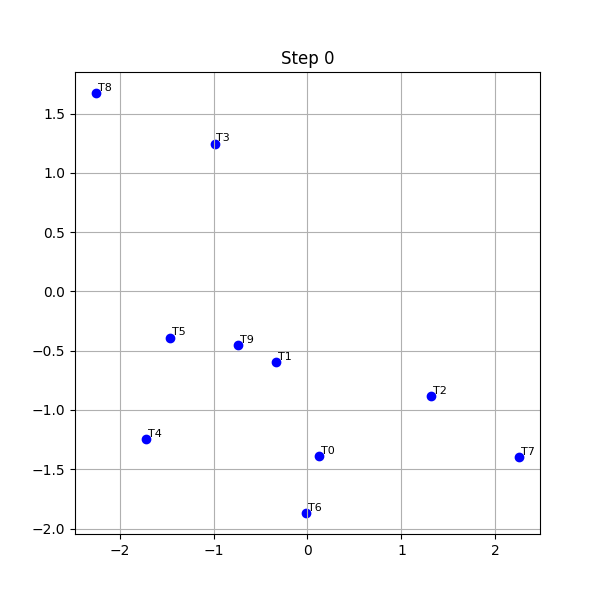

In [63]:
from matplotlib.animation import FuncAnimation
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt # Import matplotlib

all_embedding = np.stack(snapshots) # stack over time

# Reshape the all_embedding array to have 2 dimensions
reshaped_embedding = all_embedding.reshape(-1, all_embedding.shape[-1])

pca = PCA(n_components=2)
pca.fit(reshaped_embedding) # Fit PCA on the reshaped data

snapshots_2d = [pca.transform(s) for s in snapshots]  # project each step

# ------------------------
# Animation
# ------------------------
fig, ax = plt.subplots(figsize=(6, 6))
scat = ax.scatter([], [], c='blue')
texts = []

def init():
    # Use the transformed data for setting limits
    all_snapshots_2d = np.vstack(snapshots_2d)
    ax.set_xlim(np.min(all_snapshots_2d[:,0]) - 1, np.max(all_snapshots_2d[:,0]) + 1)
    ax.set_ylim(np.min(all_snapshots_2d[:,1]) - 1, np.max(all_snapshots_2d[:,1]) + 1)
    ax.set_title("Embedding Movement Over Time (PCA)")
    return scat,

def update(frame):
    ax.clear()
    ax.set_title(f"Step {frame}")
    coords = snapshots_2d[frame]
    ax.scatter(coords[:, 0], coords[:, 1], c='blue')
    for i, (x, y) in enumerate(coords):
        ax.text(x + 0.02, y + 0.02, f"T{i}", fontsize=8)
    ax.grid(True)

ani = FuncAnimation(fig, update, frames=len(snapshots_2d), init_func=init, interval=500)

# # Save animation as GIF (Google Colab can display this inline)
# from matplotlib.animation import PillowWriter
# ani.save("embedding_movement.gif", writer=PillowWriter(fps=2))

plt.close(fig)

from IPython.display import Image
Image(filename="embedding_movement.gif")

# mini GPT like training to illustrating real training of embeddng layer

* Create a toy vocabulary: ["dog", "barks", "loud"]
* Assign each word a token ID: 0, 1, 2
* Build a 2-layer model:
embedding layer → linear projection → softmax
* Use cross-entropy loss
* Train it on tiny sequences like "dog → barks", "barks → loud"
* Visualize how the embedding vectors change

In [117]:
import numpy as np

# fix seed for reproduciblity
np.random.seed(42)

#------------
# Toy vocabulary
#-----------=

vocab = ['barks', 'cry', 'dog', 'happy', 'johny', 'lilly', 'loud']
token_to_id = {word: i for i, word in enumerate(vocab)}
id_to_token = {i: word for word, i in token_to_id.items()}

vocab_size = len(vocab)
embedding_dim = 4

#----------------
# Model Paramters
#----------------
embedding_matrix = np.random.randn(vocab_size, embedding_dim) # Maps ID to learnable vectors
output_weights = np.random.randn(embedding_dim, vocab_size) # Basic 1 layer Multilayer perceptron , maps the embedding vector to scores(logits) for next token prediction

#----------
# Training data (X -> Y)
# ---------
train_pairs = [
    ("dog", "barks"),
    ("barks", "loud"),
    ("johny","happy"),
    ("lilly", "cry")
]

# Tokenize
train_data = [(token_to_id[x], token_to_id[y]) for x,y in  train_pairs]

#--------
# Helper functions
#---------
def softmax(logits):
    exp_logits = np.exp(logits - np.max(logits))
    return exp_logits / np.sum(exp_logits)

def cross_entropy(pred_probs, target_index):
    return -np.log(pred_probs[target_index])

def one_hot(index, size):
    vec = np.zeros(size)
    vec[index]=1
    return vec

#-----------------
# Training Loop
#-----------------
steps = 50
history = []
debug = False
snapshots = []

for step in range(steps):
    total_loss = 0
    snapshots.append(embedding_matrix.copy())

    # Look for the vector representing the input token
    for input_id, target_id in train_data:
        #-------- Forward pass--------
        input_word = id_to_token[input_id]
        target = id_to_token[target_id]
        embedding = embedding_matrix[input_id] # embedding_dim
        logits = embedding @ output_weights
        probs= softmax(logits)

        loss = cross_entropy(probs, target_id)
        # print("loss is : ", loss)
        total_loss+=loss

        #--------- Backward pass-------
        dL_dlogits = probs.copy()
        dL_dlogits[target_id] -= 1  #probs - one_hot(target_id, len(vocab))
        dL_dlogits = dL_dlogits.reshape(1,-1) # Row vector

        dL_dW = embedding[:,None] @ dL_dlogits
        dL_dE = dL_dlogits @ output_weights.T

        #--------Gradient update -------
        output_weights -= learning_rate* dL_dW
        embedding_matrix[input_id] -= learning_rate * dL_dE.flatten()

        if debug:
            print("input word : ", input_word)
            print("target word : ", target)
            print("shape of embedding: ", embedding.shape)
            print("embedding is :", embedding)
            print("shape of logits : ", logits.shape)
            print("logits are : ", logits)
            print("probs: \n", probs)
            print("prob(predicted) :.", dL_dlogits)
            print("shape of dl_dlogits: ", dL_dlogits.reshape(1,-1))
            print("embeding :,None", embedding[:, None].shape) # Column vector
            print("weight gradient: ", dL_dW)
            print("value of dL_dE: ", dL_dE)

    avg_loss = total_loss/len(train_data)
    history.append(avg_loss)

    if step % 5 == 0:
        print(f"[Step {step}]  Avg Loss: {avg_loss:.4f}")

# prediction
def predict_next_word(input_token, top_k=3):
    input_id = token_to_id[input_token]
    embedding = embedding_matrix[input_id]
    logits = embedding @ output_weights
    probs = softmax(logits)

    # Top - K predictions
    top_indices = probs.argsort()[::-1][:top_k]
    print(f"\nInput: '{input_token}' → Predictions:")
    for rank, idx in enumerate(top_indices):
        print(f"{rank+1}. {id_to_token[idx]} (p={probs[idx]:.3f})")

    return id_to_token[top_indices[0]]

next_word = predict_next_word("dog", top_k=1)
next_word = predict_next_word("johny", top_k=1)
next_word = predict_next_word("lilly", top_k=1)
next_word = predict_next_word("barks", top_k=1)
predict_next_word("barks")
print(next_word)

[Step 0]  Avg Loss: 2.8272
[Step 5]  Avg Loss: 0.8982
[Step 10]  Avg Loss: 0.3893
[Step 15]  Avg Loss: 0.1934
[Step 20]  Avg Loss: 0.1142
[Step 25]  Avg Loss: 0.0772
[Step 30]  Avg Loss: 0.0570
[Step 35]  Avg Loss: 0.0446
[Step 40]  Avg Loss: 0.0363
[Step 45]  Avg Loss: 0.0304

Input: 'dog' → Predictions:
1. barks (p=0.974)

Input: 'johny' → Predictions:
1. happy (p=0.975)

Input: 'lilly' → Predictions:
1. cry (p=0.970)

Input: 'barks' → Predictions:
1. loud (p=0.978)

Input: 'barks' → Predictions:
1. loud (p=0.978)
2. lilly (p=0.008)
3. johny (p=0.007)
loud


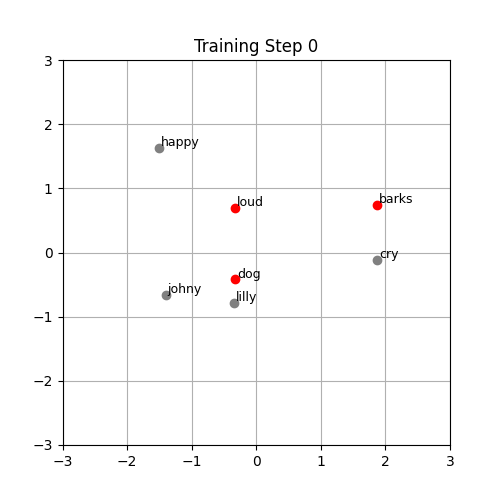

In [118]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from sklearn.decomposition import PCA

# 1. Fix PCA axes using final step
pca = PCA(n_components=2)
pca.fit(snapshots[-1])  # fit on final snapshot

# 2. Project all snapshots to 2D
snapshots_2d = [pca.transform(s) for s in snapshots]

# 3. Animation setup
fig, ax = plt.subplots(figsize=(5, 5))

def update(frame):
    ax.clear()
    coords = snapshots_2d[frame]
    ax.set_title(f"Training Step {frame}")
    for i, (x, y) in enumerate(coords):
        token = id_to_token.get(i, f"?{i}")
        color = 'red' if token in ["dog", "barks", "loud"] else 'gray'
        ax.scatter(x, y, color=color)
        ax.text(x + 0.03, y + 0.03, token, fontsize=9)
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    ax.grid(True)

ani = FuncAnimation(fig, update, frames=len(snapshots_2d), interval=300)
ani.save("embedding_evolution.gif", writer=PillowWriter(fps=3))
plt.close()

# Display in Google Colab
from IPython.display import Image
Image(filename="embedding_evolution.gif")

# Weight Tying

Here only the input vectors are in the embedding are updated here,

the problem here is, for eg: Dog has 1 vector in the embedding space
but Bark has 2 vectors representing it in the model
1. Input vector E[1] - used when barks is input
2. Output vector W[:,1] - used when predicting "bark"

ie, when we take the dot product of input and vector of bark in W space we get higher logits

**these are totaly seperate parameters - no garantee they'll be similar**

This is weight tying nessosary , that we have to tie both input embedding matrix to output projection matrix,
Wout = E.t

in multilayer perceptive:
eg:

Let's say the input token is `"dog"` (id = 0).

### 1. Embedding lookup
$$e_{\text{dog}} = E[0] \quad \text{shape } (4,)$$

### 2. Layer 1 (linear transform to 10 dims)
$$h_1 = e_{\text{dog}} W_1 \quad (4 \times 10 \Rightarrow 10)$$

### 3. Layer 2 (another linear transform)
$$h_2 = h_1 W_2 \quad (10 \times 10 \Rightarrow 10)$$

### 4. Output projection to vocab
$$\text{logits} = h_2 W_{\text{out}} \quad (10 \times 3 \Rightarrow 3)$$

These 3 numbers are the raw scores for:
* `"dog"`
* `"barks"`
* `"loud"`

### 5. Softmax converts logits → probabilities over vocab.

### What Is $h$, $W$, and $E[i]$ Here?

* $E[i]$ — **embedding vector** for token $i$ (input representation)  
  This is **only at the very bottom** — maps a token id to a vector.

* $h$ — **final hidden state before output projection**  
  In your 3-layer example:
  $$h = h_2$$
  It is the result after all intermediate layers ($W_1$, $W_2$, activations, etc.).

* $W_{\text{out}}$ — **output projection matrix**  
  This maps the final hidden state $h$ to logits over the vocabulary.

### Where Weight Tying Fits

Weight tying **does not** involve $W_1$ or $W_2$ at all. It only ties the **final output projection matrix** to the **input embedding matrix**.

In the tied setup:
$$W_{\text{out}} = E^T$$

* But here 10,3 does n't match to 3,4. to solve this problem , usually final hidden layer has a shape of embedding_dim

## With weight tying

* You have **one shared parameter set**:
  * $E \in \mathbb{R}^{V \times d}$
  * And you enforce:
    $W_{\text{out}} = E^T$

* During training:
  * **Forward pass**:
    $\text{logits} = h E^T$
  * **Backward pass**:
    * Gradients flow into $E$ from **two directions**:
      1. **Input role** → the row for the input token
      2. **Output role** → the row for the target token (because output columns = input rows)
    * Since $W_{\text{out}}$ is not a separate parameter, you **don't update it separately** — it's literally just `E.T`.

* Result:
  * `"dog"` and `"barks"` share the same geometry
  * Updating `"barks"` as an output also updates `"barks"` as an input

# Weight Tying in Different Model Types

## 1️⃣ In text language models (GPT, BERT, etc.)

* Weight tying **is standard** now.
* First popularized in 📄 *"Using the Output Embedding to Improve Language Models"* (Press & Wolf, 2017) 📄 *"Tying Word Vectors and Word Classifiers"* (Inan et al., 2017)
* GPT-2, GPT-3, LLaMA, Falcon, etc. all:
  1. Use one embedding matrix $E$ of shape $[V, d_{\text{model}}]$
  2. Keep all hidden states in $d_{\text{model}}$ space
  3. Output projection = $E^T$

**Reason it works so well in text**:
* Vocabulary space is discrete and fixed
* Input & output share same semantic units (tokens)
* It halves the parameters and improves generalization

## 2️⃣ In TTS models

* In autoregressive text-to-speech (e.g. VALL-E, Tacotron's decoder), weight tying **can** be applied **only** if:
  * The model predicts *discrete* audio tokens from the same vocabulary it uses as inputs in another step (rare in pure TTS, more common in speech-to-speech or unit-based models)
* In most TTS, the input is **text tokens** and the output is **acoustic tokens** (different vocabularies, different semantic meaning), so weight tying **doesn't apply directly**.
* Example: VALL-E predicts audio VQ codes → output projection is **separate** from text embedding.

## 3️⃣ Why it's not universal

Weight tying only works when:
* **Input and output tokens come from the same set** (language modeling, translation decoder side, BERT MLM head)
* **Model dimension matches embedding dimension** (common in transformers)

If input/output spaces differ (like in:
* TTS: phonemes → audio tokens
* Image captioning: image embeddings → text tokens ), you can't just tie — you need different embeddings.

## 4️⃣ Is making output dim = input embedding dim SOTA now?

For **language modeling**:
* Yes, it's the de facto standard
* Most SOTA LMs keep $d_{\text{model}}$ constant throughout the transformer layers so tying is possible

For **multi-modal / TTS**:
* No, because input & output embeddings represent different modalities

## ✅ Rule of thumb:
**If the prediction space = input token space → tie weights**  
**Else → separate weights**

In [119]:
# Lets implement weight sharing for our previous example,
# We remove output_weights as a separate matrix
# We compute logits using embedding_matrix.T
# We update only embedding_matrix, which now learns from both input and output roles automatically

import numpy as np

# fix seed for reproducibility
np.random.seed(42)

#------------
# Toy vocabulary
#------------
vocab = ['barks', 'cry', 'dog', 'happy', 'johny', 'lilly', 'loud']
token_to_id = {word: i for i, word in enumerate(vocab)}
id_to_token = {i: word for word, i in token_to_id.items()}

vocab_size = len(vocab)
embedding_dim = 4
learning_rate = 0.1

#----------------
# Model Parameters (only embeddings)
#----------------
# This single matrix will serve as both input embeddings and output projection (tied)
embedding_matrix = np.random.randn(vocab_size, embedding_dim)

#----------
# Training data (X -> Y)
#----------
train_pairs = [
    ("dog", "barks"),
    ("barks", "loud"),
    ("johny", "happy"),
    ("lilly", "cry")
]

# Tokenize
train_data = [(token_to_id[x], token_to_id[y]) for x, y in train_pairs]

#--------
# Helper functions
#--------
def softmax(logits):
    exp_logits = np.exp(logits - np.max(logits))
    return exp_logits / np.sum(exp_logits)

def cross_entropy(pred_probs, target_index):
    return -np.log(pred_probs[target_index])

#-----------------
# Training Loop
#-----------------
steps = 50
history = []
snapshots = []

for step in range(steps):
    total_loss = 0
    snapshots.append(embedding_matrix.copy())

    for input_id, target_id in train_data:
        #-------- Forward pass --------
        embedding = embedding_matrix[input_id]  # shape (embedding_dim,)
        logits = embedding @ embedding_matrix.T  # W_out = E^T
        probs = softmax(logits)

        loss = cross_entropy(probs, target_id)
        total_loss += loss

        #--------- Backward pass --------
        dL_dlogits = probs.copy()
        dL_dlogits[target_id] -= 1  # softmax - one_hot
        dL_dlogits = dL_dlogits.reshape(1, -1)  # (1, vocab_size)

        # Gradient w.r.t. input embedding (row input_id)
        grad_input = dL_dlogits @ embedding_matrix  # (1, embedding_dim)
        embedding_matrix[input_id] -= learning_rate * grad_input.flatten()

        # Gradient w.r.t. output embeddings (rows target_id and all others)
        grad_output = dL_dlogits.T @ embedding.reshape(1, -1)  # (vocab_size, embedding_dim)
        embedding_matrix -= learning_rate * grad_output

    avg_loss = total_loss / len(train_data)
    history.append(avg_loss)

    if step % 5 == 0:
        print(f"[Step {step}] Avg Loss: {avg_loss:.4f}")

#-----------------
# Prediction
#-----------------
def predict_next_word(input_token, top_k=3):
    input_id = token_to_id[input_token]
    embedding = embedding_matrix[input_id]
    logits = embedding @ embedding_matrix.T
    probs = softmax(logits)

    top_indices = probs.argsort()[::-1][:top_k]
    print(f"\nInput: '{input_token}' → Predictions:")
    for rank, idx in enumerate(top_indices):
        print(f"{rank+1}. {id_to_token[idx]} (p={probs[idx]:.3f})")

    return id_to_token[top_indices[0]]

predict_next_word("dog")
predict_next_word("johny")
predict_next_word("lilly")
predict_next_word("barks")


[Step 0] Avg Loss: 3.9058
[Step 5] Avg Loss: 1.0314
[Step 10] Avg Loss: 0.6984
[Step 15] Avg Loss: 0.5688
[Step 20] Avg Loss: 0.4958
[Step 25] Avg Loss: 0.4461
[Step 30] Avg Loss: 0.4076
[Step 35] Avg Loss: 0.3749
[Step 40] Avg Loss: 0.3458
[Step 45] Avg Loss: 0.3192

Input: 'dog' → Predictions:
1. barks (p=0.455)
2. loud (p=0.287)
3. dog (p=0.208)

Input: 'johny' → Predictions:
1. happy (p=0.956)
2. johny (p=0.040)
3. loud (p=0.003)

Input: 'lilly' → Predictions:
1. cry (p=0.912)
2. lilly (p=0.080)
3. dog (p=0.004)

Input: 'barks' → Predictions:
1. loud (p=0.812)
2. barks (p=0.179)
3. dog (p=0.008)


'loud'

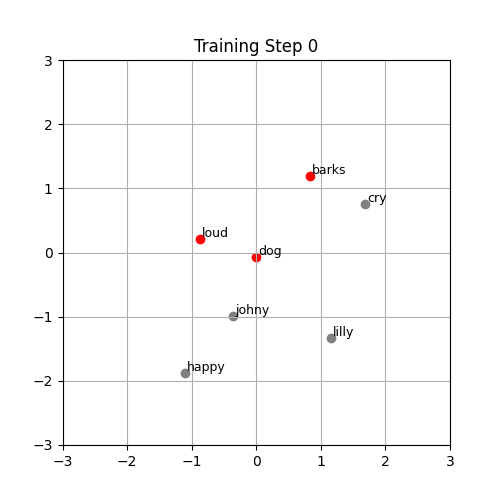

In [120]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from sklearn.decomposition import PCA

# 1. Fix PCA axes using final step
pca = PCA(n_components=2)
pca.fit(snapshots[-1])  # fit on final snapshot

# 2. Project all snapshots to 2D
snapshots_2d = [pca.transform(s) for s in snapshots]

# 3. Animation setup
fig, ax = plt.subplots(figsize=(5, 5))

def update(frame):
    ax.clear()
    coords = snapshots_2d[frame]
    ax.set_title(f"Training Step {frame}")
    for i, (x, y) in enumerate(coords):
        token = id_to_token.get(i, f"?{i}")
        color = 'red' if token in ["dog", "barks", "loud"] else 'gray'
        ax.scatter(x, y, color=color)
        ax.text(x + 0.03, y + 0.03, token, fontsize=9)
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    ax.grid(True)

ani = FuncAnimation(fig, update, frames=len(snapshots_2d), interval=300)
ani.save("embedding_evolution_weightsharing.gif", writer=PillowWriter(fps=3))
plt.close()

# Display in Google Colab
from IPython.display import Image
Image(filename="embedding_evolution_weightsharing.gif")

in above PCA Gif we could see the embedding vectors of loud, dog, bark are moivng to closer , similary for johny , happy and lilly cry

# Lets implement this in large NN, and see how weight teing is implemented there.

## Architecture

* Vocab size = $V$
* Embedding dim = Model dim = $d$
* Layers:
  1. $e = E[\text{input\_id}]$ (lookup)
  2. $z_1 = e \cdot W_1 + b_1 \rightarrow h_1 = \tanh(z_1)$ ($d \rightarrow h$)
  3. $z_2 = h_1 \cdot W_2 + b_2 \rightarrow h_2 = \tanh(z_2)$ ($h \rightarrow d$)
  4. **Weight tying**: $\text{logits} = h_2 \cdot E^T$ (output head tied to input embeddings)
  5. CE loss + softmax

## Backprop (per sample):

### Gradient Computation:
* $\frac{\partial L}{\partial \text{logits}} = \text{softmax}(\text{logits}) - \text{one\_hot}(\text{target})$

### Output-path gradient to **all rows** of $E$:
* $\text{grad}\_E\_\text{out} = \text{outer}\left(\frac{\partial L}{\partial \text{logits}}, h_2\right)$ (shape $V \times d$)

### Input-path gradient to **the input row** of $E$:
* $\frac{\partial L}{\partial h_2} = \frac{\partial L}{\partial \text{logits}} \cdot E$
* $\frac{\partial L}{\partial z_2} = \frac{\partial L}{\partial h_2} \odot (1 - \tanh^2(z_2))$
* $\frac{\partial L}{\partial W_2} = \text{outer}(h_1, \frac{\partial L}{\partial z_2})$; $\frac{\partial L}{\partial b_2} = \frac{\partial L}{\partial z_2}$
* $\frac{\partial L}{\partial h_1} = \frac{\partial L}{\partial z_2} \cdot W_2^T$
* $\frac{\partial L}{\partial z_1} = \frac{\partial L}{\partial h_1} \odot (1 - \tanh^2(z_1))$
* $\frac{\partial L}{\partial W_1} = \text{outer}(e, \frac{\partial L}{\partial z_1})$; $\frac{\partial L}{\partial b_1} = \frac{\partial L}{\partial z_1}$
* $\text{grad}\_e\_\text{in} = \frac{\partial L}{\partial z_1} \cdot W_1^T$

### Update:
* $E[\text{input\_id}] \leftarrow E[\text{input\_id}] - \alpha \cdot \text{grad}\_e\_\text{in}$
* $E \leftarrow E - \alpha \cdot \text{grad}\_E\_\text{out}$ (affects target row and others)
* Update $W_1, b_1, W_2, b_2$ with their respective gradients

Where $\alpha$ is the learning rate and $\odot$ denotes element-wise multiplication.

In [158]:
import numpy as np

# ---------------------------
# Setup
# ---------------------------
np.random.seed(42)

vocab = ['barks', 'cry', 'dog', 'happy', 'johny', 'lilly', 'loud']
token_to_id = {w:i for i,w in enumerate(vocab)}
id_to_token = {i:w for w,i in token_to_id.items()}

V = len(vocab)
d = 8          # embedding/model dim (make it a bit bigger to see movement)
h = 12         # hidden width for the middle layer
lr = 0.1
steps = 500
weight_decay = 1e-4

# Data (X->Y)
train_pairs = [
    ("dog", "barks"),
    ("barks", "loud"),
    ("johny","happy"),
    ("lilly","cry"),
]
train_data = [(token_to_id[x], token_to_id[y]) for x,y in train_pairs]

# ---------------------------
# Parameters (tied head)
# ---------------------------
E  = np.random.randn(V, d) * 0.1     # shared: input embeddings AND output head (transposed)
W1 = np.random.randn(d, h) * 0.1
b1 = np.zeros(h)
W2 = np.random.randn(h, d) * 0.1
b2 = np.zeros(d)

def softmax(logits):
    x = logits - np.max(logits)
    ex = np.exp(x)
    return ex / np.sum(ex)

def ce_loss(probs, target_idx):
    return -np.log(probs[target_idx] + 1e-12)

def layernorm(x, eps=1e-5):
    mean = np.mean(x)
    std = np.std(x)
    return (x - mean) / (std + eps)

def clip_grad(g, max_norm=1.0):
    norm = np.linalg.norm(g)
    if norm > max_norm:
        return g * (max_norm / (norm + 1e-9))
    return g


history = []
snapshots = []
snaps_E, snaps_W1, snaps_b1, snaps_W2, snaps_b2 = [], [], [], [], [] # for visualization

# ---------------------------
# Training
# ---------------------------
for step in range(steps):
    total_loss = 0.0
    snapshots.append(E.copy())
    snaps_E.append(E.copy())
    snaps_W1.append(W1.copy())
    snaps_b1.append(b1.copy())
    snaps_W2.append(W2.copy())
    snaps_b2.append(b2.copy())

    for x_id, y_id in train_data:
        # ---- Forward ----
        e  = E[x_id]                             # (d,)
        z1 = layernorm(e @ W1 + b1)                         # (h,)
        h1 = np.tanh(z1)
        z2 = layernorm(h1 @ W2 + b2)                        # (d,)
        h2 = np.tanh(z2)
        logits = h2 @ E.T                        # (V,)   # W_out = E^T (tied)
        probs  = softmax(logits)
        loss   = ce_loss(probs, y_id)
        total_loss += loss

        # ---- Backward ----
        # dL/dlogits
        dlogits = probs.copy()
        dlogits[y_id] -= 1.0                     # (V,)

        # Output path grads: to E (all rows)
        # grad_E_out[v, :] = dlogits[v] * h2
        grad_E_out = dlogits[:, None] * h2[None, :]       # (V, d)

        # Backprop to h2 through tied head
        dh2 = dlogits @ E                         # (d,)

        # Back through tanh(z2)
        dz2 = dh2 * (1.0 - np.tanh(z2)**2)        # (d,)

        # Grads for W2, b2, and h1
        dW2 = np.outer(h1, dz2)                   # (h, d)
        db2 = dz2                                 # (d,)
        dh1 = dz2 @ W2.T                          # (h,)

        # Back through tanh(z1)
        dz1 = dh1 * (1.0 - np.tanh(z1)**2)        # (h,)

        # Grads for W1, b1, and input embedding row
        dW1 = np.outer(e, dz1)                    # (d, h)
        db1 = dz1                                 # (h,)
        de  = dz1 @ W1.T                          # (d,)

        # gradient cliping prevents extreme updates when gradient spikes
        de = clip_grad(de)
        grad_E_out = clip_grad(grad_E_out)
        dW1 = clip_grad(dW1)
        dW2 = clip_grad(dW2)

        # ---- SGD updates ----
        # shared embeddings:
        #   - input role: only the input row x_id
        #   - output role: all rows via grad_E_out
        E[x_id] -= lr * de
        E       -= lr * grad_E_out

        # middle layers
        W2 -= lr * dW2
        b2 -= lr * db2
        W1 -= lr * dW1
        b1 -= lr * db1

        # slight weight decay to prevent norm explosion
        E   -= weight_decay * E
        W1  -= weight_decay * W1
        W2  -= weight_decay * W2
        b1 -= weight_decay * b1
        b2 -= weight_decay * b2

    history.append(total_loss / len(train_data))
    if step % 10 == 0:
        print(f"[step {step:03d}] loss: {history[-1]:.4f}")


# ---------------------------
# Inference
# ---------------------------
def predict_next(token, top_k=3):
    x_id = token_to_id[token]
    e  = E[x_id]
    h1 = np.tanh(e @ W1 + b1)
    h2 = np.tanh(h1 @ W2 + b2)
    logits = h2 @ E.T
    probs = softmax(logits)
    top = probs.argsort()[::-1][:top_k]
    print(f"\nInput: {token}")
    for r,i in enumerate(top, 1):
        print(f"{r}. {id_to_token[i]}  p={probs[i]:.3f}")
    return id_to_token[top[0]]

predict_next("dog")
predict_next("barks")
predict_next("johny")
predict_next("lilly")


[step 000] loss: 2.0277
[step 010] loss: 0.6935
[step 020] loss: 0.2264
[step 030] loss: 0.1191
[step 040] loss: 0.0796
[step 050] loss: 0.0597
[step 060] loss: 0.0479
[step 070] loss: 0.0400
[step 080] loss: 0.0344
[step 090] loss: 0.0303
[step 100] loss: 0.0271
[step 110] loss: 0.0245
[step 120] loss: 0.0224
[step 130] loss: 0.0207
[step 140] loss: 0.0192
[step 150] loss: 0.0180
[step 160] loss: 0.0169
[step 170] loss: 0.0160
[step 180] loss: 0.0152
[step 190] loss: 0.0144
[step 200] loss: 0.0138
[step 210] loss: 0.0132
[step 220] loss: 0.0127
[step 230] loss: 0.0122
[step 240] loss: 0.0118
[step 250] loss: 0.0114
[step 260] loss: 0.0110
[step 270] loss: 0.0107
[step 280] loss: 0.0104
[step 290] loss: 0.0101
[step 300] loss: 0.0098
[step 310] loss: 0.0096
[step 320] loss: 0.0093
[step 330] loss: 0.0091
[step 340] loss: 0.0089
[step 350] loss: 0.0087
[step 360] loss: 0.0086
[step 370] loss: 0.0084
[step 380] loss: 0.0082
[step 390] loss: 0.0081
[step 400] loss: 0.0080
[step 410] loss:

'cry'

## Notes,

# 🔍 Why Embeddings 'Fly Apart' in PCA

## 1. Weight tying introduces repulsion dynamics

* You're using:
  $$\text{logits}_i = \mathbf{h}_2 \cdot \mathbf{E}[i]$$

* To make `"dog" → "barks"` work, the gradient:
  * pulls `"barks"` embedding **toward** $\mathbf{h}_2$
  * pushes **other tokens** (like `"cry"`, `"loud"`, `"happy"`) **away from** $\mathbf{h}_2$

* Over time, this **expands the space**, making the vectors spread apart to **maximize prediction contrast**.

## 2. PCA only shows global projection, not semantic similarity

* PCA preserves variance, not cosine similarity
* It's possible `"dog"` and `"barks"` are becoming more **aligned** (in cosine), but PCA spreads them out due to variance growth

## 3. Prediction needs separation, not tight clustering

* For $\text{softmax}(\mathbf{h}_2 \cdot E^T)$ to assign `"barks"` high probability:
  * The dot product $\mathbf{h}_2 \cdot \mathbf{E}[\text{barks}]$ must be **high**
  * Others like $\mathbf{h}_2 \cdot \mathbf{E}[\text{cry}]$ must be **low**

* So $E$ vectors must **spread** for softmax to differentiate — this looks like "flying apart" in PCA

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


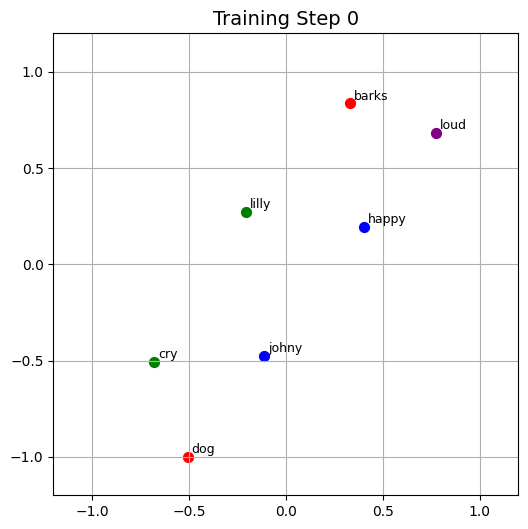

In [139]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# ======================
# 1️⃣ UMAP projection
# ======================
reducer = umap.UMAP(n_neighbors=4, min_dist=0.1, random_state=42)
snapshots_umap = [reducer.fit_transform(E) for E in snapshots]

# ======================
# 2️⃣ Normalize scale
# ======================
snapshots_umap_scaled = []
for coords in snapshots_umap:
    coords = coords - coords.mean(0)  # center
    coords = coords / (np.abs(coords).max() + 1e-9)  # scale to [-1, 1]
    snapshots_umap_scaled.append(coords)

# ======================
# 3️⃣ Define clusters & colors
# ======================
cluster_map = {
    "dog": 0, "barks": 0,
    "johny": 1, "happy": 1,
    "lilly": 2, "cry": 2,
    "loud": 3  # single cluster for now
}
cluster_colors = {
    0: "red",
    1: "blue",
    2: "green",
    3: "purple"
}

# ======================
# 4️⃣ Animation
# ======================
xmin, ymin, xmax, ymax = -1.2, -1.2, 1.2, 1.2
fig, ax = plt.subplots(figsize=(6, 6))

def update(frame):
    ax.clear()
    ax.set_title(f"Training Step {frame}", fontsize=14)

    coords = snapshots_umap_scaled[frame]

    # Draw current positions only (no trajectories)
    for i, (x, y) in enumerate(coords):
        tok = id_to_token[i]
        color = cluster_colors[cluster_map[tok]]
        ax.scatter(x, y, color=color, s=50)
        ax.text(x + 0.02, y + 0.02, tok, fontsize=9)

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.grid(True)

ani = FuncAnimation(fig, update, frames=len(snapshots_umap_scaled), interval=150)

# Show inline
HTML(ani.to_jshtml())

# Optional save
# from matplotlib.animation import PillowWriter
# ani.save("embedding_umap_clusters.gif", writer=PillowWriter(fps=10))


In [154]:
from sklearn.metrics.pairwise import cosine_similarity

sim_matrix = cosine_similarity(E) # embeddng matrix

# similarity btw dog and barks

h_dog = np.tanh(np.tanh(E[token_to_id["dog"]] @ W1 + b1) @ W2 + b2)
sim_true = cosine_similarity(h_dog.reshape(1, -1),
                              E[token_to_id["barks"]].reshape(1, -1))

sim = sim_matrix[token_to_id["dog"], token_to_id["barks"]] # calcualte pairwise similarity btw all token embeddings
sim_dl = sim_matrix[token_to_id["dog"], token_to_id["loud"]]
sim_dll = sim_matrix[token_to_id["dog"], token_to_id["lilly"]]
sim_dc = sim_matrix[token_to_id["dog"], token_to_id["cry"]]
print(f"Cosine similarity (dog , barks): {sim:.3f}")
print(f"Cosine similarity (dog , loud): {sim_dl:.3f}")
print(f"Cosine similarity (dog , lilly): {sim_dll:.3f}")
print(f"Cosine similarity (dog , cry): {sim_dc:.3f}")
print(f"Real Cosine similarity (dog , barks): {sim_true}")
predict_next("dog")

Cosine similarity (dog , barks): -0.255
Cosine similarity (dog , loud): -0.303
Cosine similarity (dog , lilly): 0.560
Cosine similarity (dog , cry): -0.065
Real Cosine similarity (dog , barks): [[0.69823891]]

Input: dog
1. barks  p=0.925
2. happy  p=0.037
3. loud  p=0.008


'barks'

# Why Weight Tying Allows Distant Embeddings

## Why this is happening

### 1. Weight tying means:
* Input embedding matrix $E$
* Output projection weights $W_{\text{out}} = E^T$
* The **same vectors** are used both for looking up inputs and producing output logits.

### 2. Prediction is not based on input–input similarity

The probability for `dog → barks` is computed as:
$$\text{logit}(\text{barks}) = h \cdot E_{\text{barks}}$$

where:
* $h$ = the hidden state after passing $E_{\text{dog}}$ through your MLP
* $E_{\text{barks}}$ = the embedding row for "barks"

This means:
* You're **not** directly comparing $E_{\text{dog}}$ with $E_{\text{barks}}$
* You're comparing the **transformed version** of $E_{\text{dog}}$ (which is $h$) with $E_{\text{barks}}$

### 3. Key insight:
$E_{\text{dog}}$ and $E_{\text{barks}}$ can be far apart in raw embedding space, but still produce a high logit after transformation.

## Analogy

It's like having:
* **Keys** ($E_{\text{input}}$) to put into a **machine** (MLP)
* The machine spits out a **query vector**
* You then compare that **query vector** to all output embeddings to pick the next word.

The key itself ($E_{\text{dog}}$) doesn't have to look like the output target key ($E_{\text{barks}}$) — the **machine in between** is what aligns them.




# Lets try Visulaize how H embedding form cluster

In [159]:
import numpy as np

def layernorm_vec(x, eps=1e-5):
    # per-vector LN (same as you used)
    m, s = np.mean(x), np.std(x)
    return (x - m) / (s + eps)

def forward_h_for_all_tokens(E, W1, b1, W2, b2):
    # returns H ∈ [V, d]: transformed embeddings for all tokens at this step
    V = E.shape[0]
    d = E.shape[1]
    H = np.zeros((V, d))
    for i in range(V):
        e  = E[i]                           # (d,)
        z1 = layernorm_vec(e @ W1 + b1)     # (h,)
        h1 = np.tanh(z1)
        z2 = layernorm_vec(h1 @ W2 + b2)    # (d,)
        h2 = np.tanh(z2)                    # (d,)
        H[i] = h2
    return H

# Build a list of H snapshots, one per training step
H_snaps = [forward_h_for_all_tokens(Es, W1s, b1s, W2s, b2s)
           for Es, W1s, b1s, W2s, b2s in zip(snaps_E, snaps_W1, snaps_b1, snaps_W2, snaps_b2)]


# Why We Transform Embeddings Instead of Direct Lookup

## Why we don't just query the embedding table directly

If we only did:
$$\text{next token} = \arg\max_j \; \text{cosine}(E_x, E_j)$$

then:
* Predictions would only depend on **raw embedding similarity**
* The embedding table would have to **store all possible contextual meanings** of each token by itself
* That would be **too rigid** — "dog" would always be close to "barks," even in contexts where it shouldn't be (e.g., "hot dog")

## Why we *transform* embeddings first

1. **Embeddings store base meanings** — kind of like dictionary entries for tokens, not full sentence meaning.

2. The **MLP + attention layers** mix information from the current token **and its context**.

3. That transformed vector $h$ now contains:
   * Semantic meaning
   * Syntactic role
   * Contextual hints

4. Comparing $h$ to $E$ means:
   * You can produce **different predictions for the same token** in different contexts.
   * Example:
     * In "dog barks loudly" → $h_{\text{dog}}$ → high similarity with "barks"
     * In "hot dog is tasty" → $h_{\text{dog}}$ → high similarity with "is"

## Why it works mathematically

The embedding table $E$ is just a set of **basis vectors** in $\mathbb{R}^d$. The network learns a mapping:
$$f_{\theta}(E_{x_1}, E_{x_2}, \dots) \to h$$

that projects the context into the same $\mathbb{R}^d$ space **where output embeddings live**.

Because we tie weights ($W_{\text{out}} = E^T$), the model learns:
* To shape $E$ so it's good both for **input lookup** and **output matching**.
* To shape the transformation $f_{\theta}$ so that $h$ lands near the correct output vector.

## "True ideal" scenario

If you wanted to **just query the embedding matrix directly**:
* You'd basically be doing a **nearest neighbor search** without any learned transformation.
* This would work only for **static meaning** (e.g., word2vec analogy tasks).
* But you'd lose **context sensitivity**, which is why GPT, BERT, etc. **must** have those nonlinear transformations.

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


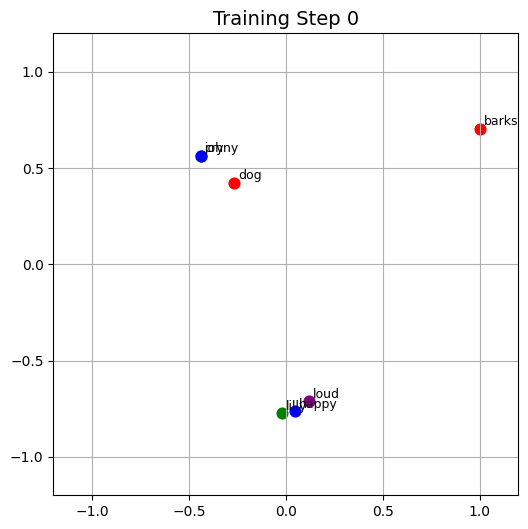

In [160]:
# !pip install umap-learn
import umap
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Fit UMAP once on all h-vectors across time for stable axes
H_all = np.vstack(H_snaps)         # [steps*V, d]
reducer = umap.UMAP(n_neighbors=4, min_dist=0.1, random_state=42)
reducer.fit(H_all)

# Transform each step
H2_snaps = [reducer.transform(H) for H in H_snaps]   # list of [V, 2]

# Normalize each frame to [-1, 1] for a stable, zoomed-in view
H2_norm = []
for coords in H2_snaps:
    c = coords - coords.mean(0)
    c = c / (np.abs(c).max() + 1e-9)
    H2_norm.append(c)

# Color clusters (same as before)
cluster_map = {
    "dog": 0, "barks": 0,
    "johny": 1, "happy": 1,
    "lilly": 2, "cry": 2,
    "loud": 3
}
cluster_colors = {0:"red", 1:"blue", 2:"green", 3:"purple"}

# Animate (no trajectories)
xmin, ymin, xmax, ymax = -1.2, -1.2, 1.2, 1.2
fig, ax = plt.subplots(figsize=(6,6))

def update(frame):
    ax.clear()
    ax.set_title(f"Training Step {frame}", fontsize=14)
    coords = H2_norm[frame]
    for i, (x, y) in enumerate(coords):
        tok = id_to_token[i]
        ax.scatter(x, y, s=60, color=cluster_colors[cluster_map[tok]])
        ax.text(x+0.02, y+0.02, tok, fontsize=9)
    ax.set_xlim(xmin, xmax); ax.set_ylim(ymin, ymax)
    ax.grid(True)

ani = FuncAnimation(fig, update, frames=len(H2_norm), interval=150)
HTML(ani.to_jshtml())

# Optional save
# from matplotlib.animation import PillowWriter
# ani.save("h_space_umap.gif", writer=PillowWriter(fps=10))


# Now lets do it with Pytorch with its latest tools like .weights, detach()

Following things are done here:

* uses weight tying (output = embedding.weight.T)
* has a 2‑layer MLP (embedding → h → logits)
* records snapshots every N steps (to keep RAM small)
* visualizes the transformed space h (the thing the model actually compares to embeddings)

In [161]:
import torch, torch.nn as nn, torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# --- Toy vocab & pairs
vocab = ['dog','barks','loud','johny','happy','lilly','cry']
token_to_id = {t:i for i,t in enumerate(vocab)}
id_to_token = {i:t for t,i in token_to_id.items()}
pairs = [('dog','barks'),('barks','loud'),('johny','happy'),('lilly','cry')]
train_data = torch.tensor([(token_to_id[x], token_to_id[y]) for x,y in pairs])

# --- Model
class TinyTiedLM(nn.Module):
    def __init__(self, V, d=8, h=16, use_layernorm=True):
        super().__init__()
        self.embedding = nn.Embedding(V, d)
        self.lin1 = nn.Linear(d, h)
        self.ln1  = nn.LayerNorm(h) if use_layernorm else nn.Identity()
        self.lin2 = nn.Linear(h, d)
        self.ln2  = nn.LayerNorm(d) if use_layernorm else nn.Identity()
        # no lm_head: we tie to embedding.weight.T at forward time

    def forward(self, x_ids):
        # x_ids: [B]
        e  = self.embedding(x_ids)               # [B, d]
        h1 = torch.tanh(self.ln1(self.lin1(e)))  # [B, h]
        h2 = torch.tanh(self.ln2(self.lin2(h1))) # [B, d]
        logits = h2 @ self.embedding.weight.T    # tied head: [B, V]
        return logits, h2

    def all_h(self):
        with torch.no_grad():
            all_ids = torch.arange(self.embedding.num_embeddings)
            _, H = self.forward(all_ids) # H vector for all tokens
            return H.cpu()                       # [V, d]

V = len(vocab)
model = TinyTiedLM(V, d=8, h=16, use_layernorm=True)
opt = torch.optim.Adam(model.parameters(), lr=0.05, weight_decay=1e-4)  # decay helps stability
loss_fn = nn.CrossEntropyLoss()

# --- Training (memory-friendly snapshots)
steps = 120
snapshot_every = 4
H_snaps = []   # list of [V, d] tensors
E_snaps = []   # optional, not used for viz here

def clip_grad_(params, max_norm=1.0):
    torch.nn.utils.clip_grad_norm_(params, max_norm) # Prevent Gradient explosion, computes global L2 norm,if that norm is greater than maxnorm and then it rescales all grads so total norm equals to max norm

for step in range(steps):
    total = 0.0
    for x_id, y_id in train_data:
        logits, h = model(x_id.view(1))
        loss = loss_fn(logits, y_id.view(1))
        opt.zero_grad()
        loss.backward()
        clip_grad_(model.parameters(), max_norm=1.0) # applied before weight updates
        opt.step()
        total += loss.item()

    if (step % 10) == 0:
        print(f"[step {step:03d}] avg loss per pair: {total/len(train_data):.4f}")

    if step % snapshot_every == 0:
        H_snaps.append(model.all_h())                  # Captures h2 for all tokens at that step [V,d]
        E_snaps.append(model.embedding.weight.detach().cpu().clone())  # (embedding matrix -> breaks from autograd so it won't keep history -> move to cpu -> make a copy )

# --- Quick sanity: top-1 predictions
def predict(tok):
    with torch.no_grad():
        i = torch.tensor([token_to_id[tok]])
        logits, _ = model(i)
        probs = logits.softmax(-1)[0].cpu().numpy() # shape : [batch, vocab]-> softmax over last dim, single token
        top = probs.argsort()[::-1][:3]
        print(f"\nInput: {tok}")
        for r,j in enumerate(top,1):
            print(f"{r}. {id_to_token[j]}  p={probs[j]:.3f}")

for t in ["dog","barks","johny","lilly"]:
    predict(t)

[step 000] avg loss per pair: 2.4899
[step 010] avg loss per pair: 0.0092
[step 020] avg loss per pair: 0.0033
[step 030] avg loss per pair: 0.0023
[step 040] avg loss per pair: 0.0017
[step 050] avg loss per pair: 0.0014
[step 060] avg loss per pair: 0.0012
[step 070] avg loss per pair: 0.0010
[step 080] avg loss per pair: 0.0009
[step 090] avg loss per pair: 0.0008
[step 100] avg loss per pair: 0.0008
[step 110] avg loss per pair: 0.0007

Input: dog
1. barks  p=0.999
2. loud  p=0.000
3. johny  p=0.000

Input: barks
1. loud  p=0.999
2. happy  p=0.000
3. cry  p=0.000

Input: johny
1. happy  p=0.999
2. loud  p=0.000
3. johny  p=0.000

Input: lilly
1. cry  p=0.999
2. loud  p=0.000
3. lilly  p=0.000


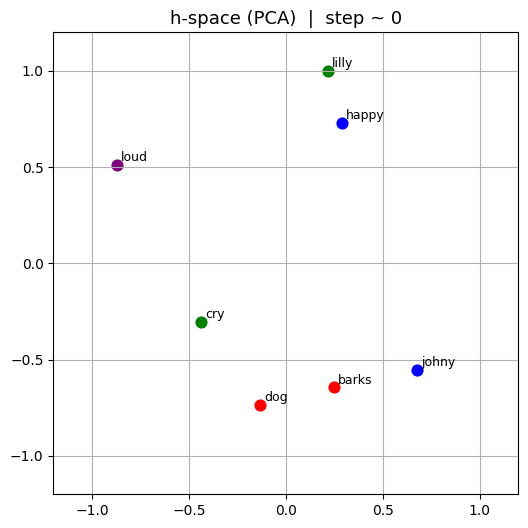

In [162]:
from sklearn.decomposition import PCA
# stack all H to fit PCA once (stable axes)
H_all = torch.cat(H_snaps, dim=0).numpy()   # [T*V, d]
pca = PCA(n_components=2)
pca.fit(H_all)

H2_snaps = [pca.transform(H.numpy()) for H in H_snaps]  # each [V,2]

# Normalize each frame to [-1,1] for a stable zoom
H2_scaled = []
for C in H2_snaps:
    Cc = C - C.mean(0, keepdims=True)
    Cc = Cc / (np.abs(Cc).max() + 1e-9)
    H2_scaled.append(Cc)

# --- Cluster colors (pairs share color)
cluster_map = {
    "dog":0, "barks":0,
    "johny":1, "happy":1,
    "lilly":2, "cry":2,
    "loud":3,
}
cluster_colors = {0:"red",1:"blue",2:"green",3:"purple"}

# --- Animate (no trajectories; stable limits)
xmin=ymin=-1.2; xmax=ymax=1.2
fig, ax = plt.subplots(figsize=(6,6))

def frame(i):
    ax.clear()
    coords = H2_scaled[i]
    ax.set_title(f"h‑space (PCA)  |  step ~ {i*snapshot_every}", fontsize=13)
    for idx,(x,y) in enumerate(coords):
        tok = id_to_token[idx]
        ax.scatter(x, y, s=60, color=cluster_colors[cluster_map[tok]])
        ax.text(x+0.02, y+0.02, tok, fontsize=9)
    ax.set_xlim(xmin, xmax); ax.set_ylim(ymin, ymax); ax.grid(True)

ani = FuncAnimation(fig, frame, frames=len(H2_scaled), interval=180)
HTML(ani.to_jshtml())